In [1]:
import sys
import tensorflow as tf
import h5py, os, yaml
import umap.umap_ as umap
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
# !pip install https://github.com/p-koo/tfomics/tarball/master
import tfomics
from test_to_bw_fast import read_model, get_config
import pandas as pd
import matplotlib.patches as patches
from tensorflow import keras
import plotly.express as px
import tfr_evaluate, util
import subprocess
import explain
from scipy.stats import pearsonr
from tqdm import tqdm

In [2]:
def describe_run(run_path, columns_of_interest=['model_fn', 'bin_size', 'crop', 'rev_comp']):
    metadata = tfr_evaluate.get_run_metadata(run_path)
    model_id = [metadata['data_dir'].values[0].split('/i_3072_w_1')[0].split('/')[-1]]
    for c in columns_of_interest:
        if c in metadata.columns:
            model_id.append(str(metadata[c].values[0]))
    return ' '.join(model_id) 

In [3]:
def get_cell_line_overlaps(cell_line):
    cmd = 'bedtools intersect -f 0.5 -wa -a /home/shush/profile/QuantPred/datasets/chr8/complete/random_chop/i_2048_w_1/sequences.bed -b /home/shush/profile/QuantPred/datasets/cell_line_specific_test_sets/cell_line_{}/complete/peak_centered/i_2048_w_1.bed | uniq > chr8_cell_line_{}_IDR.bed'.format(cell_line, cell_line)
    process = subprocess.Popen(cmd, stdout=subprocess.PIPE, shell=True)
    output, error = process.communicate()
    df = pd.read_csv('chr8_cell_line_{}_IDR.bed'.format(cell_line), sep='\t', header=None)
    idr_starts = df.iloc[:,1].values
    return idr_starts


def dna_one_hot(seq):

    seq_len = len(seq)
    seq_start = 0
    seq = seq.upper()

    # map nt's to a matrix len(seq)x4 of 0's and 1's.
    seq_code = np.zeros((seq_len, 4), dtype='float16')

    for i in range(seq_len):
        if i >= seq_start and i - seq_start < len(seq):
            nt = seq[i - seq_start]
            if nt == 'A':
                seq_code[i, 0] = 1
            elif nt == 'C':
                seq_code[i, 1] = 1
            elif nt == 'G':
                seq_code[i, 2] = 1
            elif nt == 'T':
                seq_code[i, 3] = 1
            else:
                seq_code[i,:] = 0.25

    return seq_code



In [4]:
testset, targets = tfr_evaluate.collect_whole_testset(coords=True, batch_size=512)
# threshold = 2
# _,all_X, all_Y = util.convert_tfr_to_np(testset, 3)
# above_thresh_idx = np.argwhere(all_Y[:,:,cell_line].max(axis=1)>threshold).flatten()
# filtered_X = all_X[above_thresh_idx]
# filtered_Y = all_Y[above_thresh_idx]

In [5]:
config_collection = pd.read_csv('/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/model_evaluations/binloss_basenji.csv')
run_paths = np.unique(config_collection[(config_collection['loss_fn']=='poisson') ]['run_dir'])
run_paths


array(['paper_runs/basenji/binloss_basenji/run-20210920_034449-8p51o3ho',
       'paper_runs/basenji/binloss_basenji/run-20210920_034501-7tftpu54',
       'paper_runs/basenji/binloss_basenji/run-20210920_034502-n8axwb3r',
       'paper_runs/basenji/binloss_basenji/run-20210920_075434-wilgxp1a',
       'paper_runs/basenji/binloss_basenji/run-20210920_082433-1ka588yc',
       'paper_runs/basenji/binloss_basenji/run-20210920_085441-14shgpx1',
       'paper_runs/basenji/binloss_basenji/run-20210922_044222-5ueie0zy',
       'paper_runs/basenji/binloss_basenji/run-20210923_162932-56p3xy2p'],
      dtype=object)

In [6]:
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210705_124947-5lmwz5d3' # 32
# config_collection = pd.read_csv('/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/model_evaluations/binloss_basenji.csv')
# run_path = 'paper_runs/basenji/binloss_basenji/run-20210920_075434-wilgxp1a'
# run_path = np.unique(config_collection[(config_collection['loss_fn']=='poisson') & (config_collection['bin_size']==32)]['run_dir'])[0]
layer_dict = {15:'residual block 1', 
              22:'residual block 2', 
              24:'last conv layer', 
              25:'BN before dense'}

aux_model_list = []
BIN_SIZES = []

for run_path in run_paths:
    model, bin_size = read_model(run_path, compile_model=False)
    aux_model_list.append(tf.keras.Model(inputs=model.inputs, outputs=model.layers[25].output))
    BIN_SIZES.append(bin_size)

In [7]:
aux_model_list

In [51]:
# preds = []
# for batch in util.batch_np(filtered_X, 512):
#     preds.append(model(batch))
    
# preds = np.concatenate(preds)

In [ ]:
aux_model_list = []

In [8]:
cell_lines = [4, 8, 13]
threshold = 2
variable = ('bin size', BIN_SIZES)
multicell_emb = []
for cell_line in cell_lines:
    idr_starts = get_cell_line_overlaps(cell_line)
    intermediate_outputs = {l:[] for l in variable[1]}
    idr_class = []
    for C, X, Y in tqdm(testset):
        # get data points above threshold
        above_thresh_idx = np.argwhere(Y.numpy()[:,:,cell_line].max(axis=1)>threshold).flatten()
        filtered_x = X.numpy()[above_thresh_idx, :,:]
        filtered_c = C.numpy()[above_thresh_idx]
        # for each model or layer
        for i, (aux_model) in enumerate(aux_model_list):
            interm = aux_model(filtered_x).numpy()
            intermediate_outputs[variable[1][i]].append(interm)
        idr_class.append([True if int(str(c).strip('\'b').split('_')[1]) in idr_starts else False for c in filtered_c])
    idr_class = [item for sublist in idr_class for item in sublist] # unfold the list of lists

    dfs_per_layer = []
    for bin_size, intermediate_output in intermediate_outputs.items(): # per model
        print(bin_size)
        intermediate_output = np.squeeze(np.concatenate(intermediate_output))
        reducer = umap.UMAP()
        if len(intermediate_output.shape) == 3: # reshape to 2D
            d1, d2, d3 = intermediate_output.shape
            intermediate_output = intermediate_output.reshape(d1, d2*d3)

        embedding = reducer.fit_transform(intermediate_output)
        df = pd.DataFrame({'UMAP 1':embedding[:,1], 'UMAP 2':embedding[:,0], 'IDR':idr_class})
        df[str(variable[0])] = bin_size # add model identifier
        dfs_per_layer.append(df)

    combined_embeddings = pd.concat(dfs_per_layer)
    combined_embeddings['cell line'] = targets[cell_line]
    multicell_emb.append(combined_embeddings)

137it [03:52,  1.69s/it]


32
64
128
512
1024
2048
1
256


137it [02:13,  1.02it/s]


32
64
128
512
1024
2048
1
256


137it [02:16,  1.00it/s]


32
64
128
512
1024
2048
1
256


In [12]:
# pd.concat(multicell_emb).to_csv('/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/seamonster/basenji_diff_bin_sizes_embeddigns.csv', index=None)

<Figure size 2160x1440 with 0 Axes>

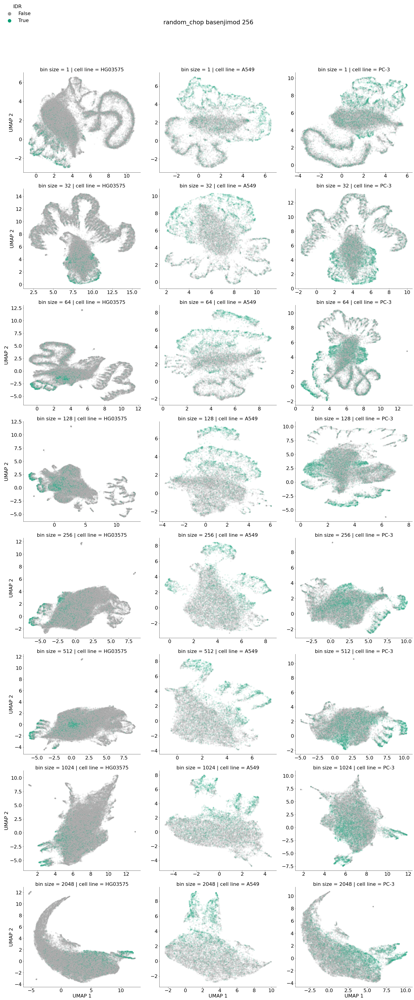

In [10]:
plt.figure(figsize=[30,20])
plt.rcParams.update({'font.size': 22})

g = sns.FacetGrid(pd.concat(multicell_emb), hue="IDR", col='cell line', row='bin size', 
                  height=8, palette=['#999999', '#009E73'], sharex=False, sharey=False) #'#05F31A'
g.map(sns.scatterplot, "UMAP 1", "UMAP 2", alpha=0.1)
g.add_legend(loc='upper left')
for lh in g._legend.legendHandles: 
    lh.set_alpha(1)
    lh._sizes = [250] 
title = describe_run(run_path)
plt.suptitle(title);
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

In [13]:
# pd.concat(multicell_emb).to_csv('seamonster/32_basenji_3cell.csv', header=None, index=None)

In [13]:
quant_model_embeddings = pd.concat(multicell_emb)
# df['id'] = df.index


In [ ]:
print('d')

In [22]:
fig = px.scatter(df, x="UMAP 1", y="UMAP 2",  
           color="IDR", opacity=0.1, hover_name="id", 
           range_x=[df['UMAP 1'].min(),df['UMAP 1'].max()], 
           range_y=[df['UMAP 2'].min(),df['UMAP 2'].max()],
#            title=describe_run(run_path)
          )

fig.add_trace(go.Scatter(x=embedding[top_points,0]))

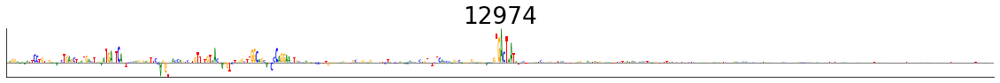

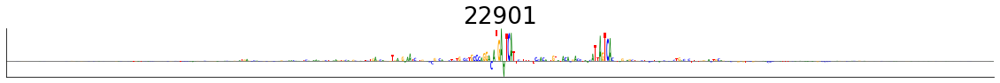

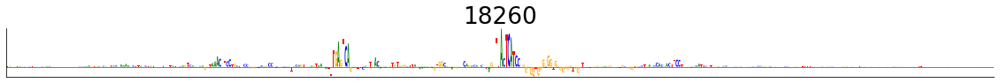

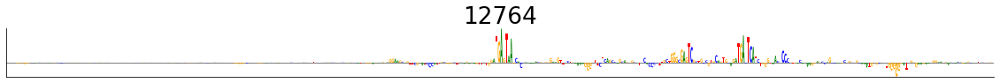

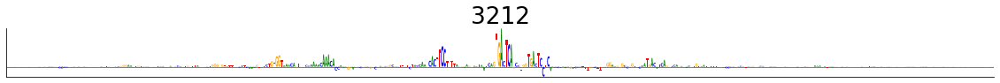

...

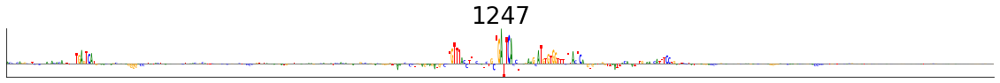

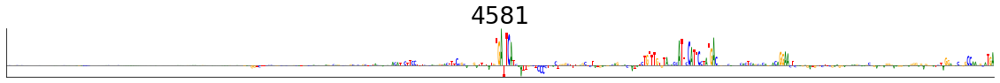

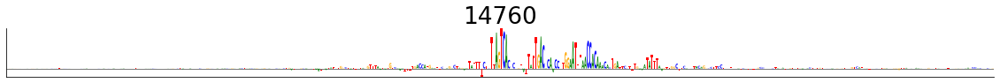

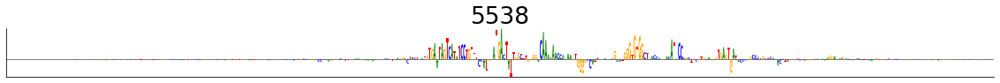

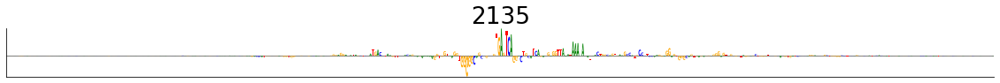

In [21]:
# left side sequences
explainer = explain.Explainer(model, class_index=cell_line)
selected_idx = [12974, 22901, 18260, 12764, 3212,
               8454, 4701, 16644, 3439, 22653,
               17712, 5510, 768, 4964, 3195,
               1247, 4581, 14760, 5538, 2135]
X_sample = filtered_X[selected_idx,:,:]
saliency_scores = explainer.saliency_maps(X_sample)

# plot attribution maps in a narrow range about max saliency value
explain.plot_saliency_logos(saliency_scores, X_sample, window=200, titles=selected_idx)

/home/shush/profile/QuantPred/explain.py:965: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 



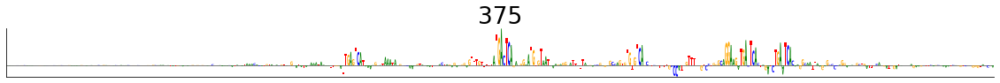

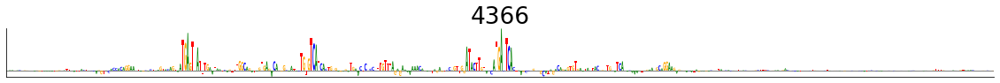

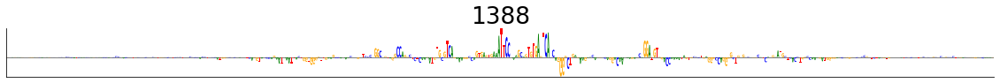

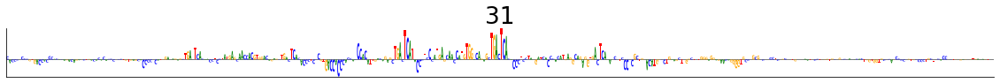

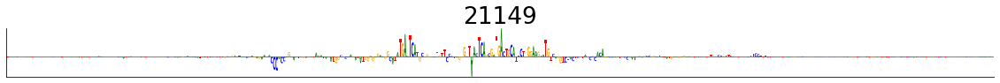

...

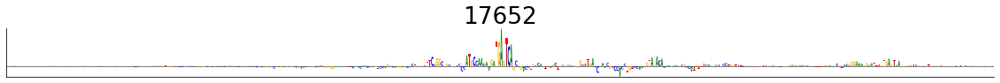

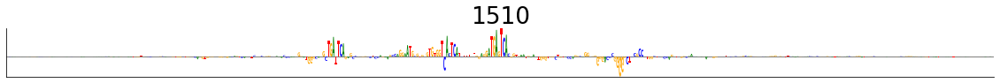

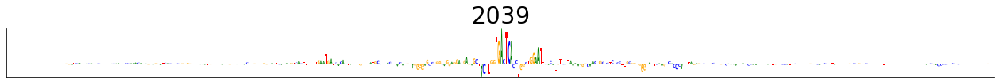

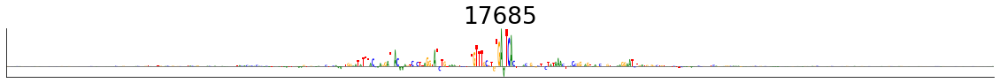

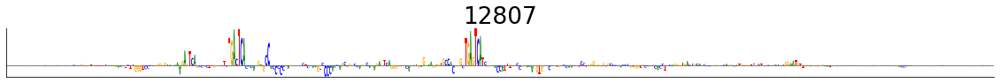

In [20]:
# right side sequences
explainer = explain.Explainer(model, class_index=cell_line)
selected_idx = [375, 4366, 1388, 31, 21149,
                19439, 7691, 19456, 1858, 16854, 
                2963, 316, 4550, 23029, 520,
               17652, 1510, 2039, 17685, 12807]
X_sample = filtered_X[selected_idx,:,:]
saliency_scores = explainer.saliency_maps(X_sample)

# plot attribution maps in a narrow range about max saliency value
explain.plot_saliency_logos(saliency_scores, X_sample, window=200, titles=selected_idx)

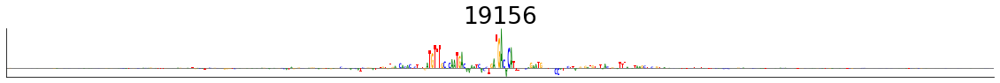

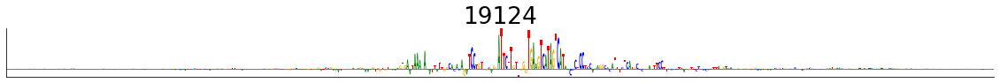

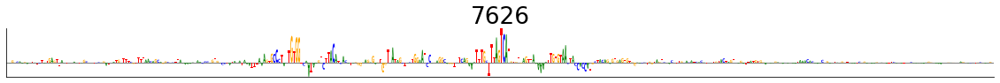

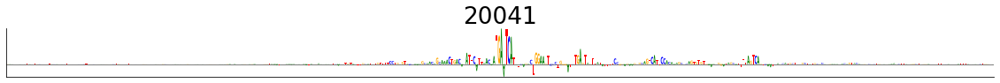

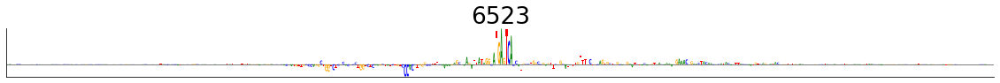

...

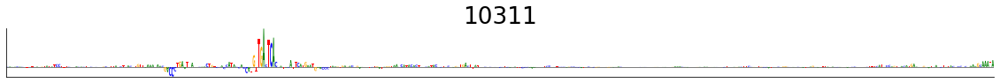

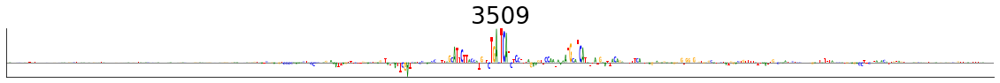

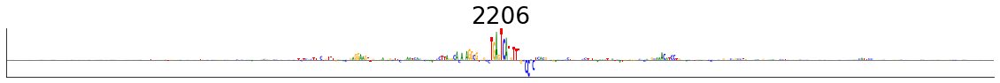

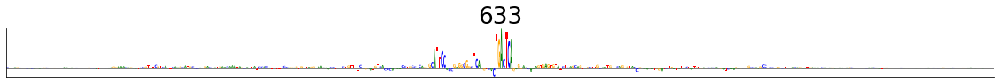

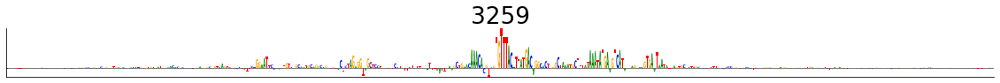

In [19]:
# blob sequences
explainer = explain.Explainer(model, class_index=cell_line)
selected_idx = [19156, 19124, 7626, 20041, 6523,
                6569, 8386, 18546, 6988, 19124, 
               5441, 8284, 16993, 11170, 3944,
               16329, 7986, 3472, 8424, 19926,
               10708, 19926, 18146, 19301, 9919,
               10311, 3509, 2206, 633, 3259]
X_sample = filtered_X[selected_idx,:,:]
saliency_scores = explainer.saliency_maps(X_sample)

# plot attribution maps in a narrow range about max saliency value
explain.plot_saliency_logos(saliency_scores, X_sample, window=200, titles=selected_idx)

/home/shush/profile/QuantPred/explain.py:942: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/home/shush/profile/QuantPred/explain.py:965: UserWarning:

Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 



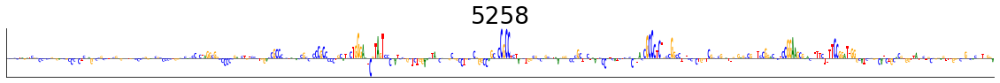

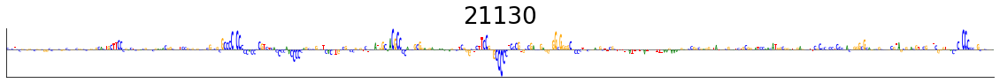

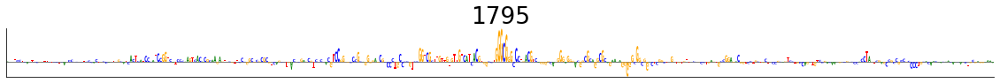

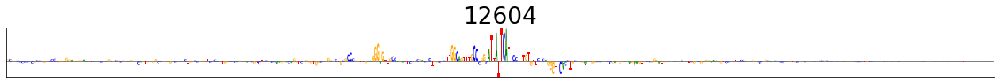

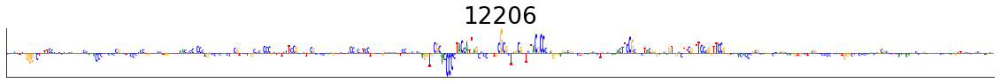

...

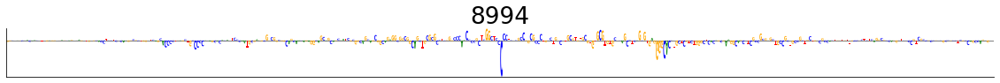

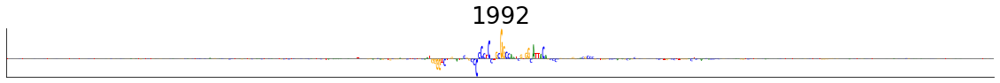

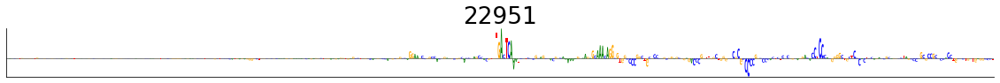

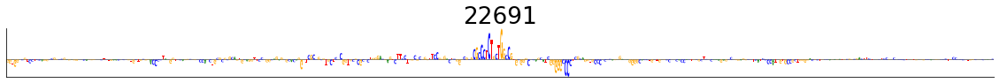

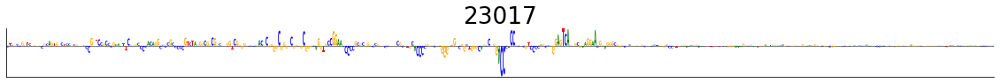

In [18]:
# top sequences
explainer = explain.Explainer(model, class_index=cell_line)
selected_idx = [5258, 21130, 1795, 12604, 12206,
                4588, 20730, 5826, 13545, 4443, 
                18555, 5826, 4177, 1022, 2911, 
               23075, 3129, 613, 22667, 51,
               12694, 23086, 2474, 3567, 4466,
               8994, 1992, 22951, 22691, 23017]
X_sample = filtered_X[selected_idx,:,:]
saliency_scores = explainer.saliency_maps(X_sample)

# plot attribution maps in a narrow range about max saliency value
explain.plot_saliency_logos(saliency_scores, X_sample, window=200, titles=selected_idx)

In [62]:
top_idx = [5258, 21130, 1795, 12604, 12206,
                4588, 20730, 5826, 13545, 4443, 
                18555, 5826, 4177, 1022, 2911, 
               23075, 3129, 613, 22667, 51,
               12694, 23086, 2474, 3567, 4466,
               8994, 1992, 22951, 22691, 23017]

top_points = embedding[top_idx]

left_idx = [12974, 22901, 18260, 12764, 3212,
               8454, 4701, 16644, 3439, 22653,
               17712, 5510, 768, 4964, 3195,
               1247, 4581, 14760, 5538, 2135]

left_points = embedding[left_idx]

right_idx = [375, 4366, 1388, 31, 21149,
                19439, 7691, 19456, 1858, 16854, 
                2963, 316, 4550, 23029, 520,
               17652, 1510, 2039, 17685, 12807]

right_points = embedding[right_idx]

blob_idx = [19156, 19124, 7626, 20041, 6523,
                6569, 8386, 18546, 6988, 19124, 
               5441, 8284, 16993, 11170, 3944,
               16329, 7986, 3472, 8424, 19926,
               10708, 19926, 18146, 19301, 9919,
               10311, 3509, 2206, 633, 3259]

blob_points = embedding[blob_idx]

<AxesSubplot:xlabel='UMAP 1', ylabel='UMAP 2'>

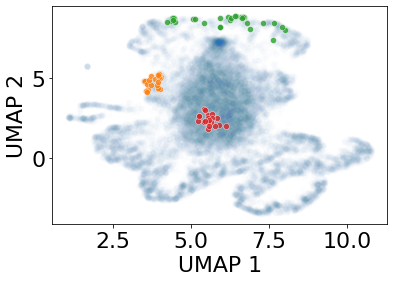

In [50]:
df = pd.concat(multicell_emb)
sns.scatterplot(data=df, x='UMAP 1', y='UMAP 2', alpha=0.01)
df = pd.DataFrame(left_points, columns=['UMAP 2', 'UMAP 1'])
sns.scatterplot(data=df, x='UMAP 1', y='UMAP 2', alpha=0.8)
sns.scatterplot(data=pd.DataFrame(top_points, columns=['UMAP 2', 'UMAP 1']), x='UMAP 1', y='UMAP 2', alpha=0.8)

sns.scatterplot(data=pd.DataFrame(blob_points[:-5], columns=['UMAP 2', 'UMAP 1']), x='UMAP 1', y='UMAP 2', alpha=0.8)




In [91]:
def plot_true_pred(idx, idx_name, cell_line=13):
    fig, axs = plt.subplots(1,2, figsize=[15,5])
    axs[0].plot(filtered_Y[idx,:,cell_line].T);
    axs[1].plot(np.repeat(preds[idx,:,cell_line], 32, axis=1).T);
    pr = []
    for i in idx:
        pr.append(pearsonr(filtered_Y[i,:,cell_line], np.repeat(preds[i,:,cell_line], 32))[0])
    pr = np.round(np.mean(pr),3)

    plt.suptitle('{} points, mean per seq pearson r = {}'.format(idx_name, pr));

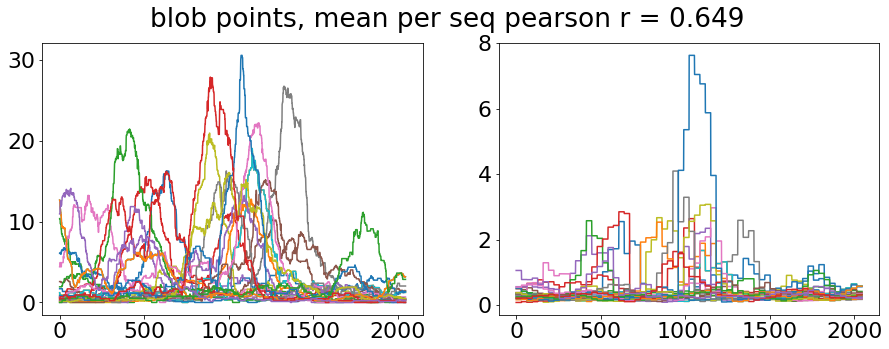

In [95]:
plot_true_pred(blob_idx[:-5], 'blob')

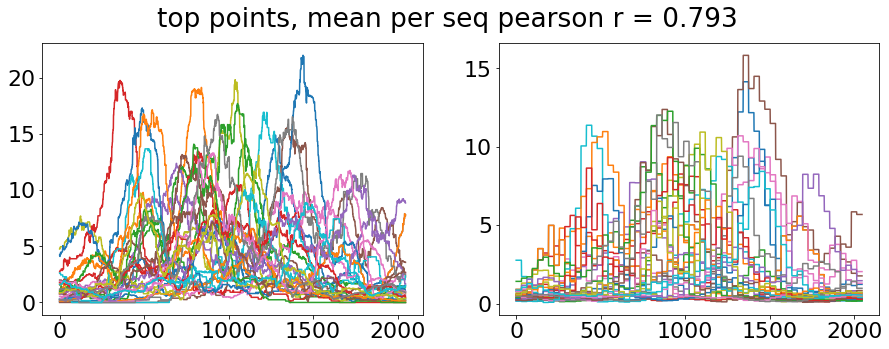

In [93]:
plot_true_pred(top_idx, 'top')

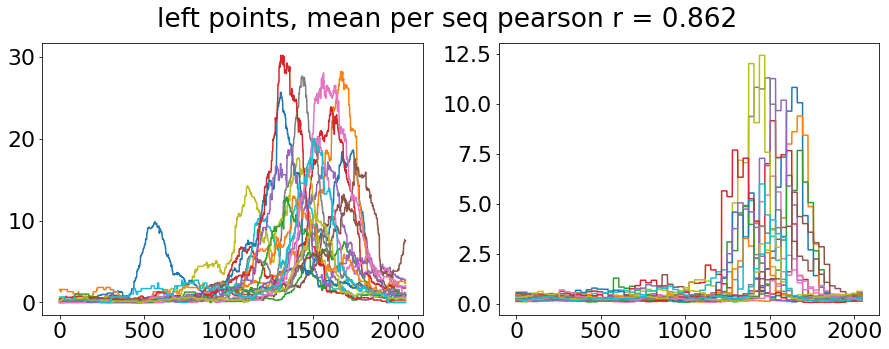

In [94]:
plot_true_pred(left_idx, 'left')

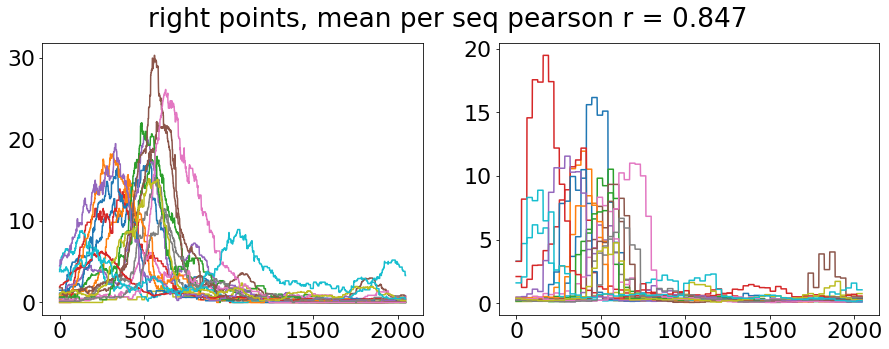

In [96]:
plot_true_pred(right_idx, 'right')

In [111]:
pattern = 'TGACTCA'
pattern_onehot = dna_one_hot(pattern)

In [107]:
blob_idx[9:10]

[19124]

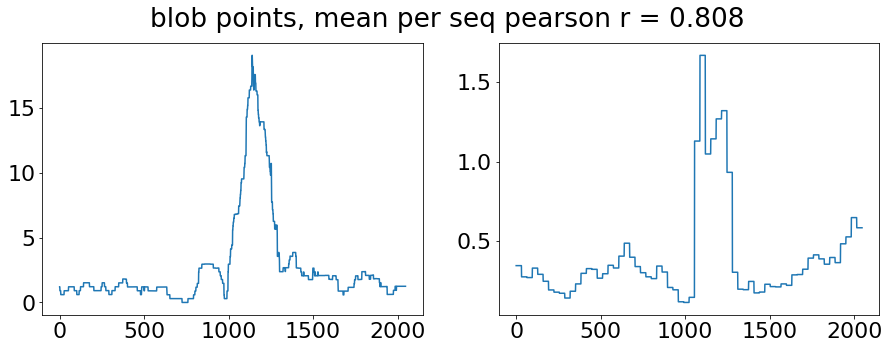

In [105]:
plot_true_pred(blob_idx[9:10], 'blob')

In [110]:
blob_x = filtered_X[19124,:,:].copy()

In [119]:

for i in [400, 1024, 800, 1500]:
    blob_x[i:i+7,:] = pattern_onehot 




In [120]:
blob_modified_pred = model(np.expand_dims(blob_x, axis=0))

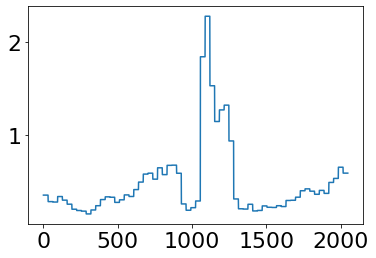

In [121]:
plt.plot(np.repeat(blob_modified_pred[0,:,13], 32))

In [98]:
# run_path_2048 = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210708_054512-6o9aiemr' # 2K
# run_path_512 = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210707_075709-uagtphvc'
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_elzar/run-20210805_225520-4jmi917g' # base resolution basenji
# run_path = '/mnt/906427d6-fddf-41bf-9ec6-c3d0c37e766f/amber/elzar_wandb/run-20210823_113229-cvwwhn2l' # best bpnet from augmentation
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_amber/run-20210804_161352-v3cllxs2' # binned bpnet
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210706_210747-i6y823ij' 

# testset = util.make_dataset(data_dir, 'test', sts, batch_size=512, shuffle=False)
# targets = pd.read_csv(data_dir+'targets.txt', sep='\t')['identifier'].values
# run_path = '/mnt/31dac31c-c4e2-4704-97bd-0788af37c5eb/shush/wandb/wandb_bizon/run-20210705_124947-5lmwz5d3' # 32


In [91]:
# basset_run = 'basset/run-20210831_022930-hiln8r84/'
# model = tf.keras.models.load_model(basset_run+'files/model-best.h5')

In [11]:
# %%time 

reducer = umap.UMAP(min_dist = 0.0001)
embedding = reducer.fit_transform(intermediate_outputs)

In [7]:
# embedding = np.load('embedding_32.npy')

In [14]:
# np.save('embedding_32.npy', embedding)

In [9]:
label_dict = {False:'non-IDR', True:'IDR'}
txt_lab = [label_dict[h] for h in hue_idr_mask]

<AxesSubplot:>

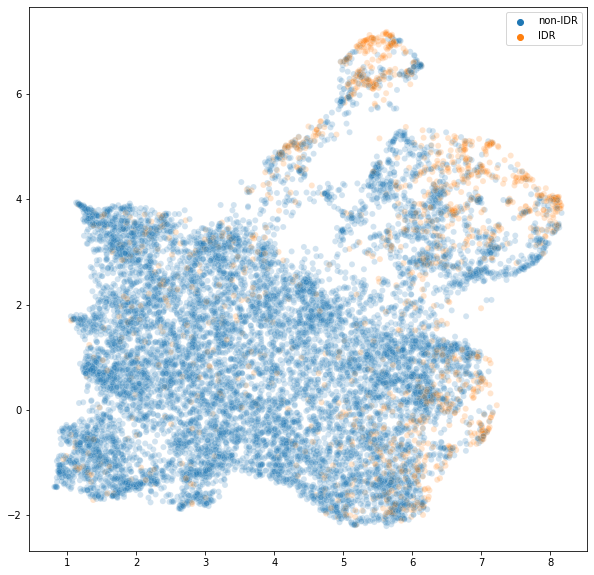

In [12]:
fig = plt.figure(figsize=[10,10]) 
sns.scatterplot(
  x=embedding[:, 1],
  y=embedding[:, 0],
  alpha=0.2, hue=txt_lab
)

# Let's probe embeddings

<AxesSubplot:>

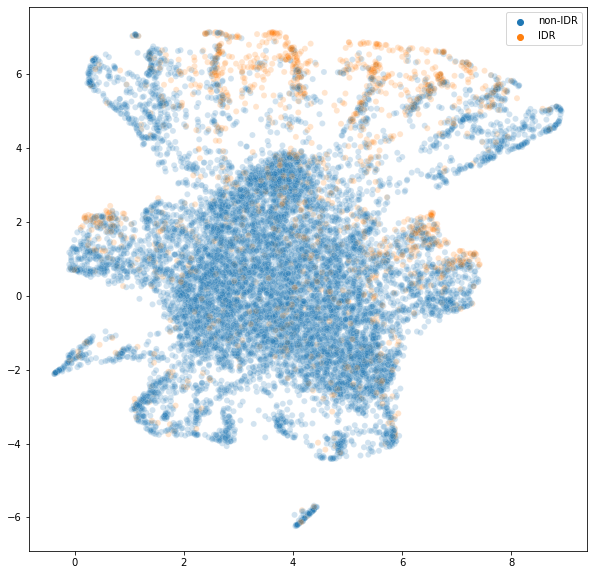

In [10]:
fig = plt.figure(figsize=[10,10]) 
sns.scatterplot(
  x=embedding[:, 1],
  y=embedding[:, 0],
  alpha=0.2, hue=txt_lab
)

In [11]:
x=embedding[:, 0]
y=embedding[:, 1]

class_index= 8
idr_index = np.where(hue_idr_mask)[0]

# create explainer class <-- to run saliency analysis
explainer = Explainer(model, class_index=class_index)

In [12]:
# get model predictions
pred = []
for tensor in dataset:
    pred.append(model(tensor).numpy())
pred = np.concatenate(pred)


# now let's probe different regions

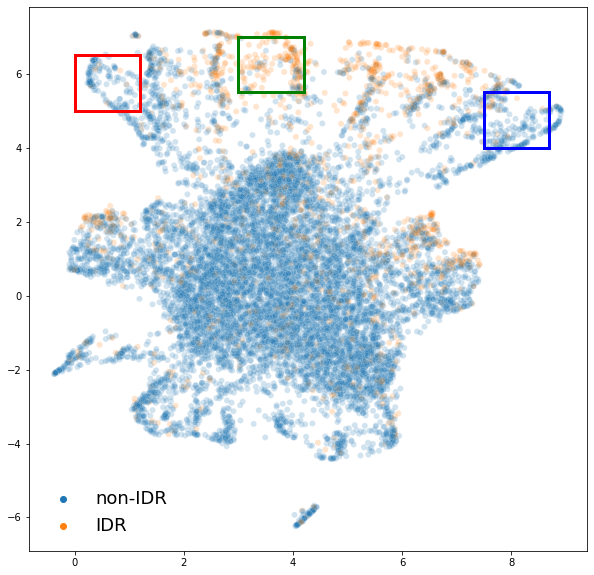

In [13]:
cluster_list = plot_embedding_with_box(embedding, [(0,5), (3,5.5), (7.5,4)]) 
#                                                    (6,0), (3,0), (-0.2,0.7)])

In [33]:
def plot_all(index, color_edge='k', file_prefix='out'):
#     index = np.array(list(set(index).intersection(set(idr_index))))
    if len(index)>50:
        np.random.seed(42)
        print(len(index))
        
        cluster_index = np.random.choice(index, 100, replace=False)
    else:
        cluster_index = index
    
    plot_embedding(embedding, cluster_index)
    class_index = 8
    fig, axs = plt.subplots(1,3, figsize=[15, 3])
    p = pred[cluster_index,:,class_index]
    y = Y[cluster_index, :, 0]

    all_plots = np.concatenate([p.flatten(),y.flatten()])
    y_max = all_plots.max()
    plt.rcParams.update({'font.size': 18})

    axs[0].plot(y.T, alpha=0.4)
    axs[1].plot(np.repeat(p, bin_size, 1).T, alpha=0.4);
    axs[0].set_ylim(0,y_max)
    axs[1].set_ylim(0, y_max)
    axs[0].set_yticks([0,15])
    axs[1].set_yticks([0,15])
    axs[0].set_xlab('')
    # sns.set(font_scale=1.3)  # crazy big
# sns.set_style(style='white')
# plt.rcParams['xtick.major.size'] = 9
# plt.rcParams['xtick.major.width'] = 1

# plt.rcParams['ytick.major.size'] = 9
# plt.rcParams['ytick.major.width'] = 1
# plt.rcParams['xtick.bottom'] = True
# plt.rcParams['ytick.left'] = True
    saliency_scores = explainer.saliency_maps(X[cluster_index])

    # plot raw saliency values
#     plot_saliency_values(saliency_scores, X[cluster_index], color_edge=color_edge, file_prefix=file_prefix)
    for i in range(len(saliency_scores)):
        grad_times_input = np.sum(saliency_scores[i]*X[cluster_index][i], axis=1)
        plt.plot(grad_times_input, alpha=0.4)
#     # plot attribution maps in a narrow range about max saliency value
#     print(saliency_scores.shape)
#     print(X[cluster_index].shape)
#     plot_saliency_logos(saliency_scores, X[cluster_index], window=200, num_plot=1)
#     binned_Y = Y[index, :,0].reshape(index.shape[0], 2048//256, 256).mean(axis=-1)
#     preds = predictions[index, :, 8]
#     pr = []
#     for i,p in enumerate(preds):
#         pr.append(stats.pearsonr(binned_Y[i,:], p)[0])
#     return pr

152
(100, 2048, 4)
(100, 2048, 4)


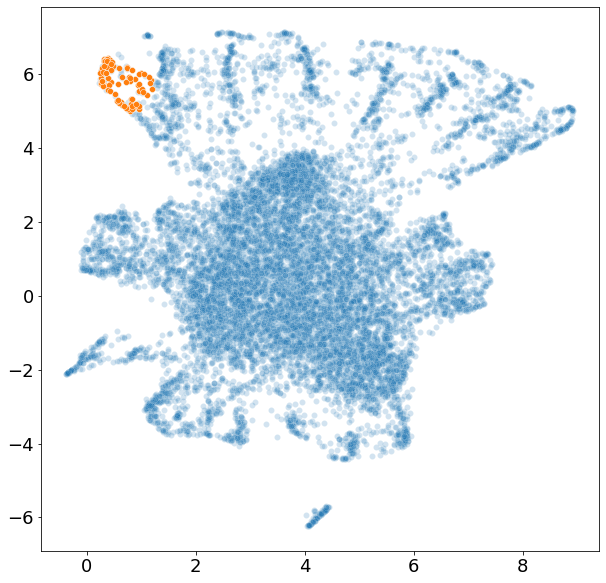

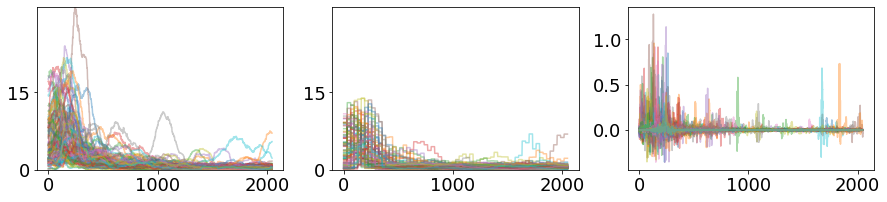

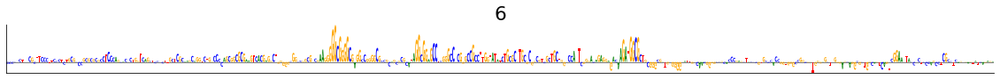

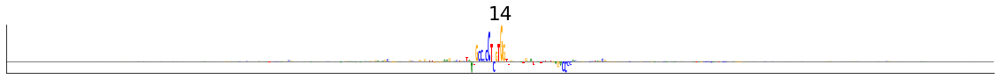

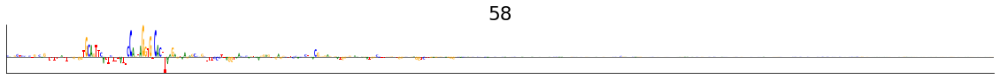

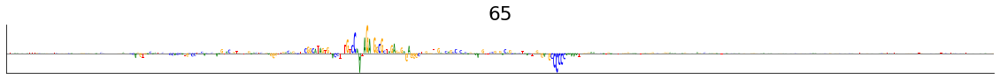

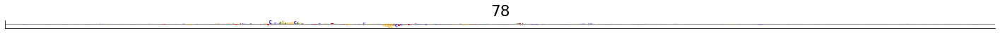

In [34]:
plot_all(cluster_list[0], color_edge='r', file_prefix='0')

# np.nanmean(pr)

186
(100, 2048, 4)
(100, 2048, 4)


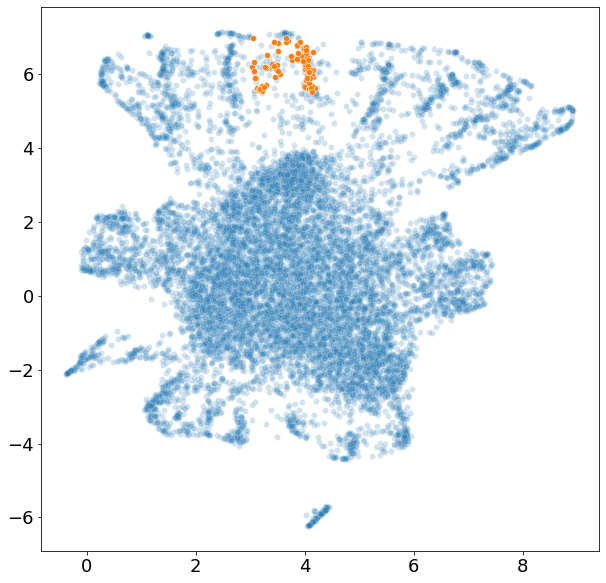

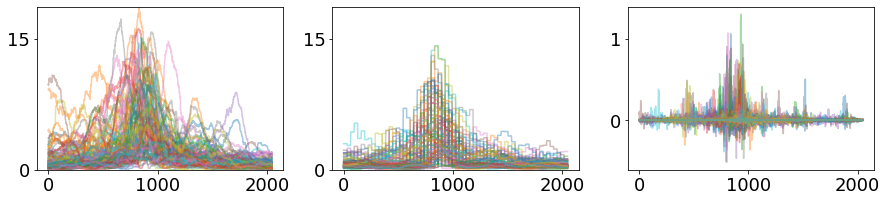

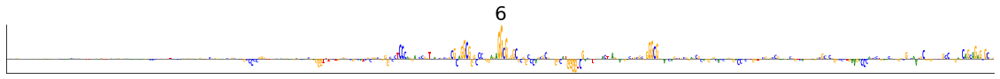

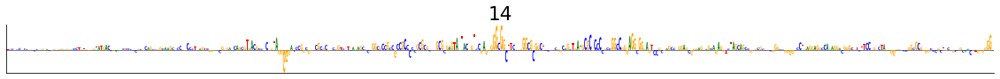

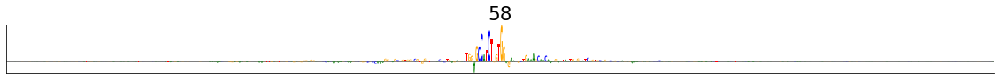

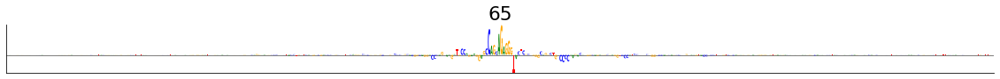

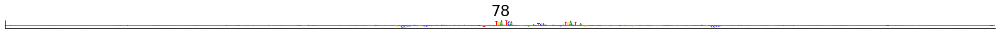

In [35]:

# index = np.where((y >6)&(x < 3)&(x>0))[0]
pr = plot_all(cluster_list[1], color_edge='g', file_prefix='1')


192
(100, 2048, 4)
(100, 2048, 4)


/home/shush/tf_2/lib/python3.7/site-packages/ipykernel_launcher.py:113: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


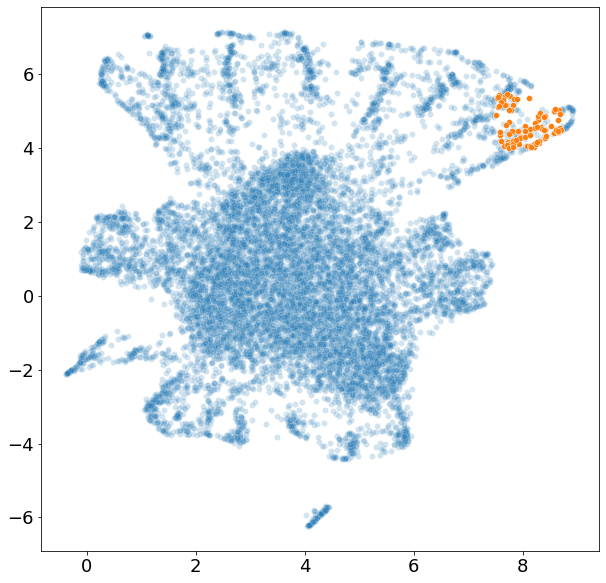

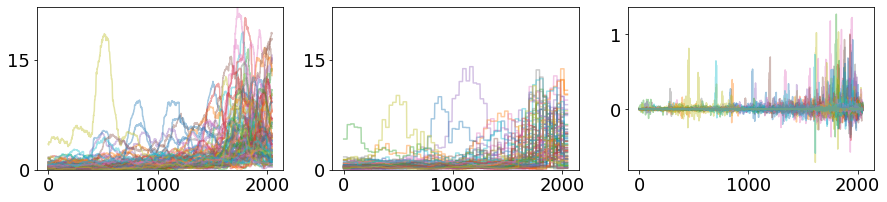

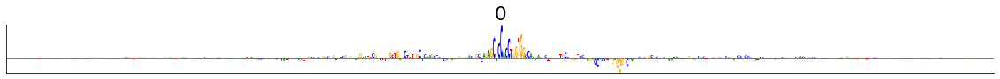

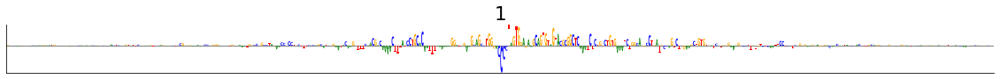

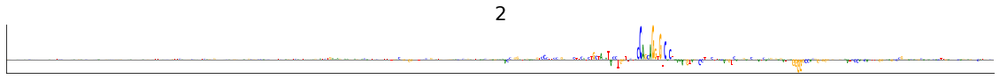

...

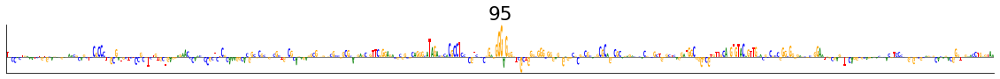

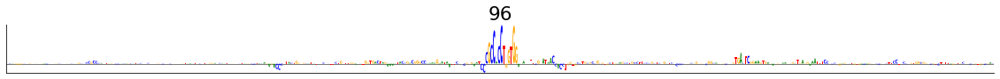

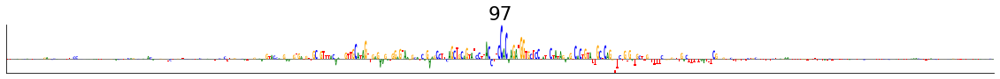

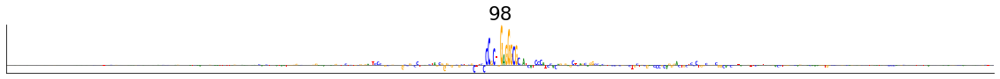

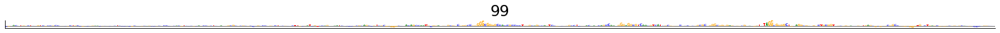

In [38]:
pr = plot_all(cluster_list[2], color_edge='b', file_prefix='2')



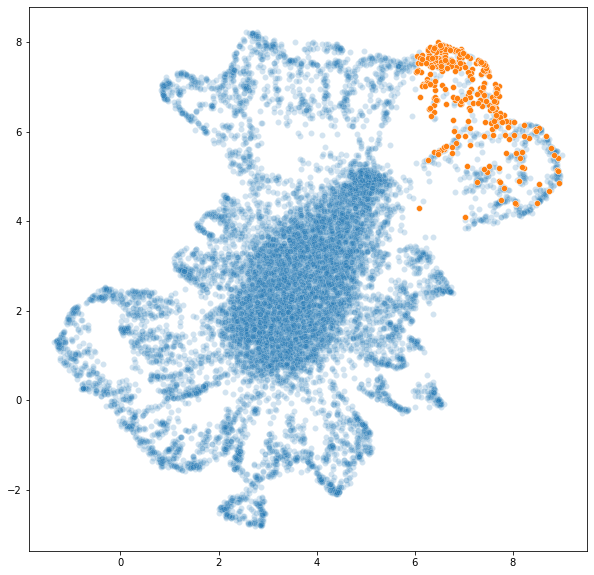

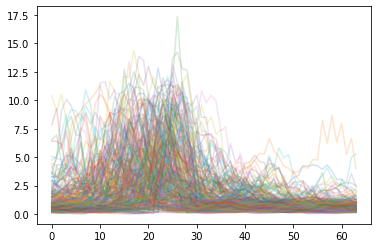

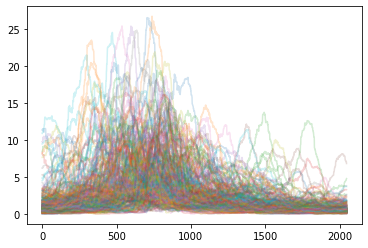

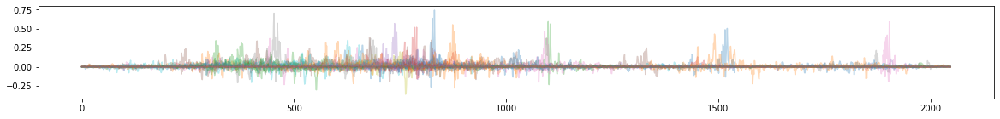

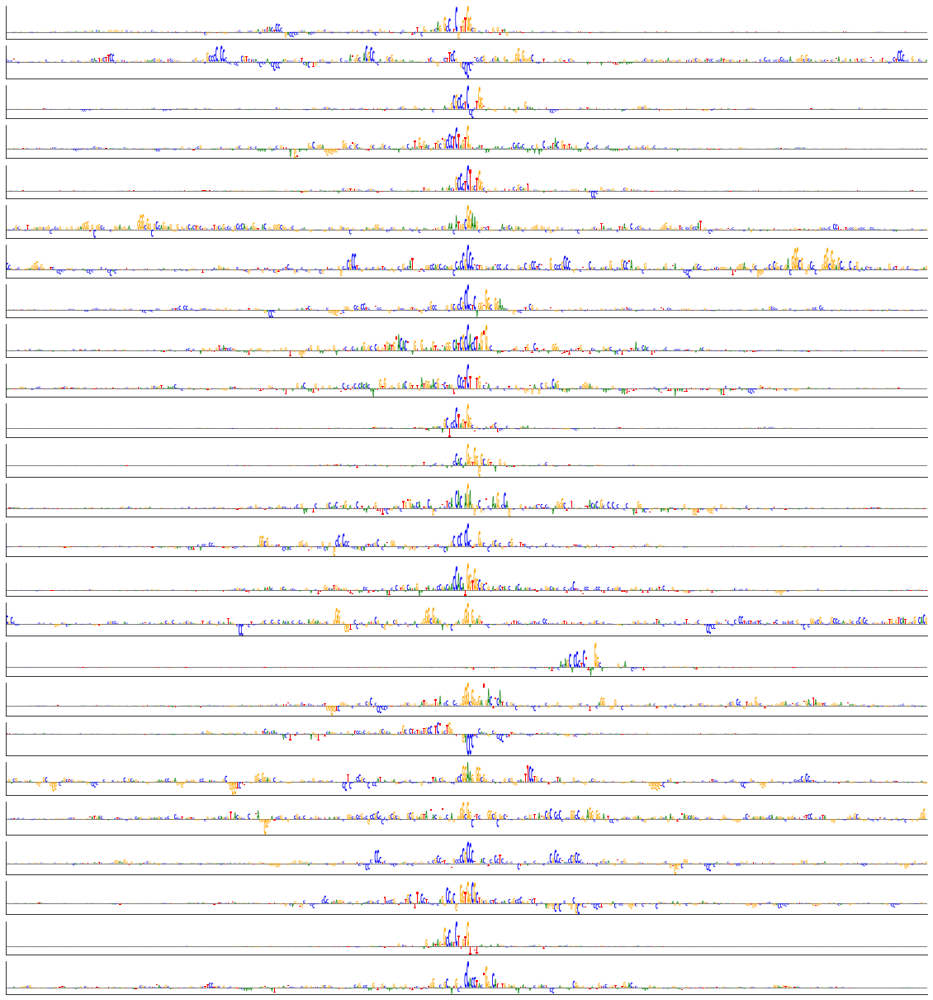

In [ ]:
index = np.where((y >4)&(x > 6))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


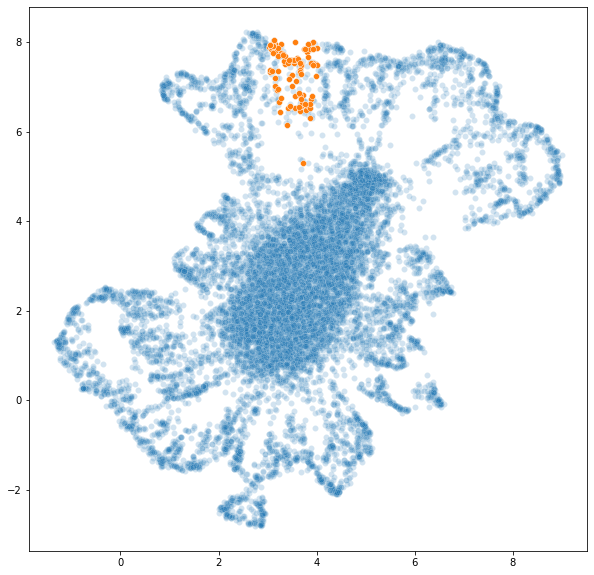

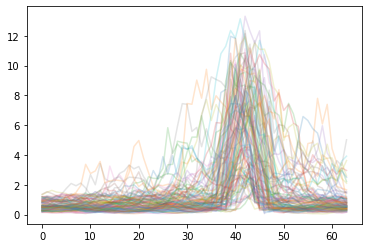

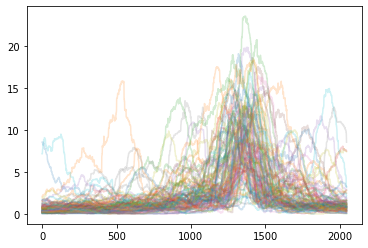

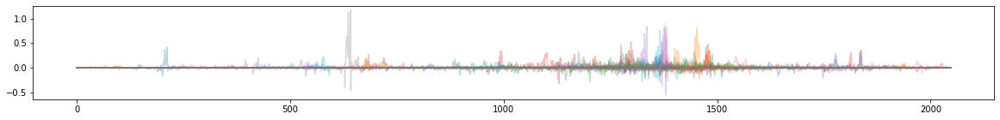

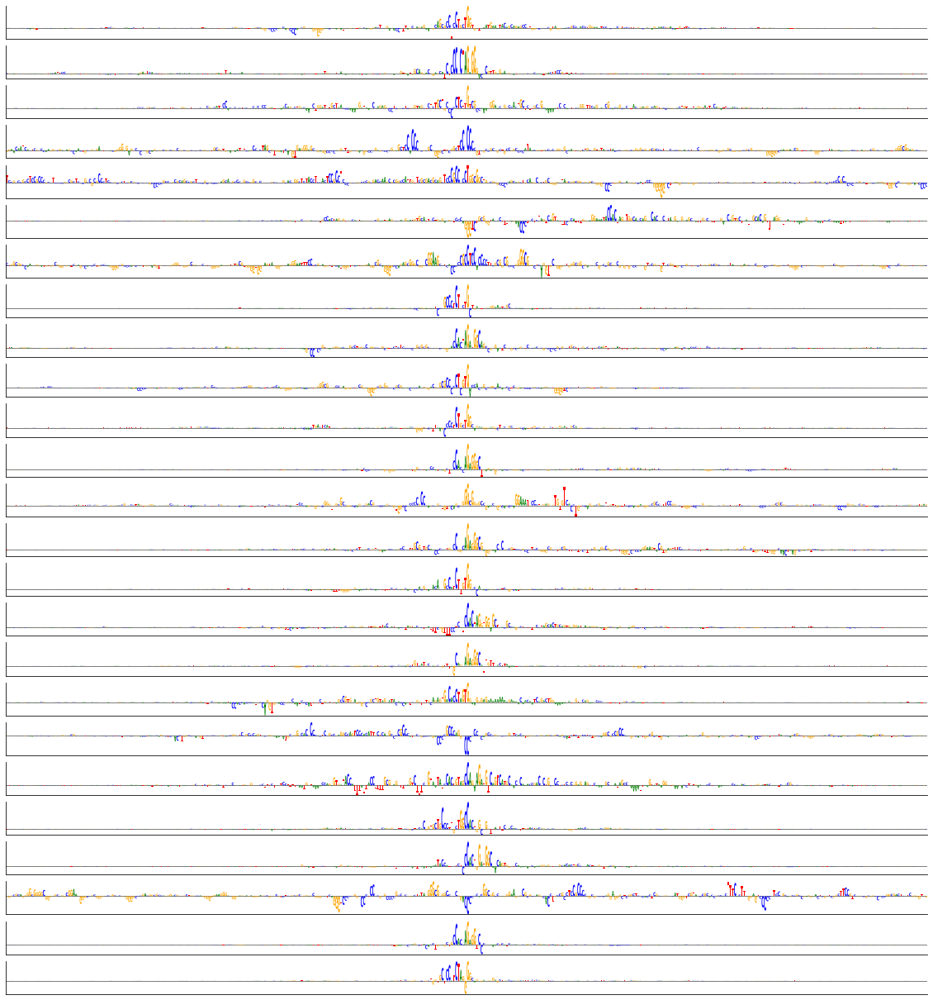

In [ ]:
index = np.where((y > 5)&(x < 4)&(x>3))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


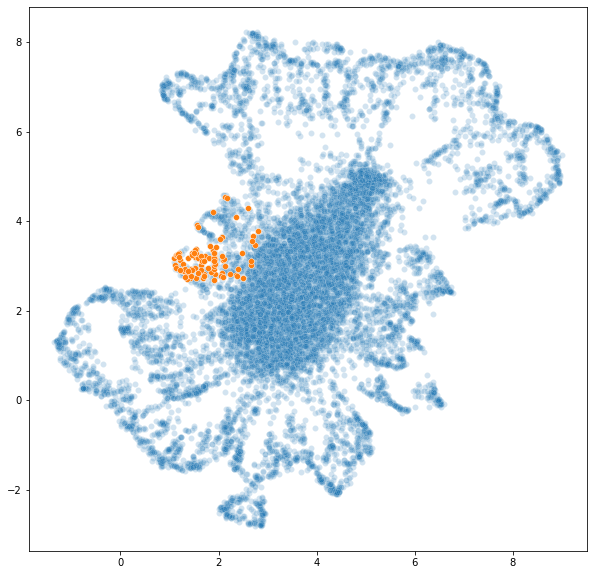

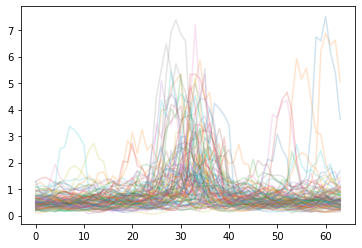

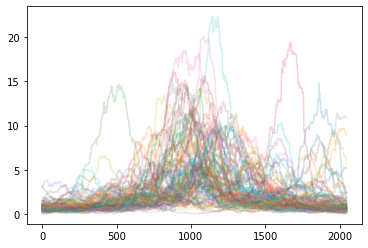

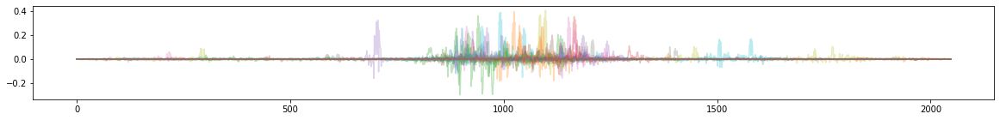

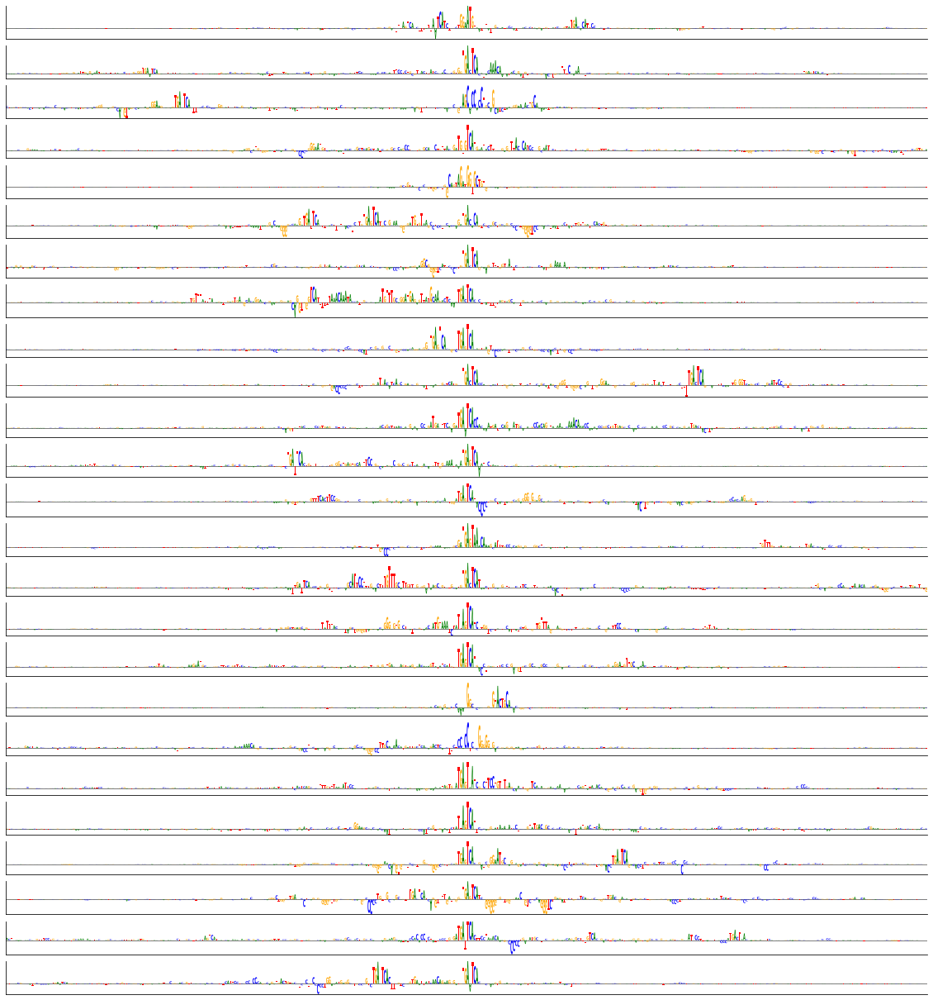

In [ ]:
index = np.where((y > 2.7)&(y < 5)&(x < 2.8))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


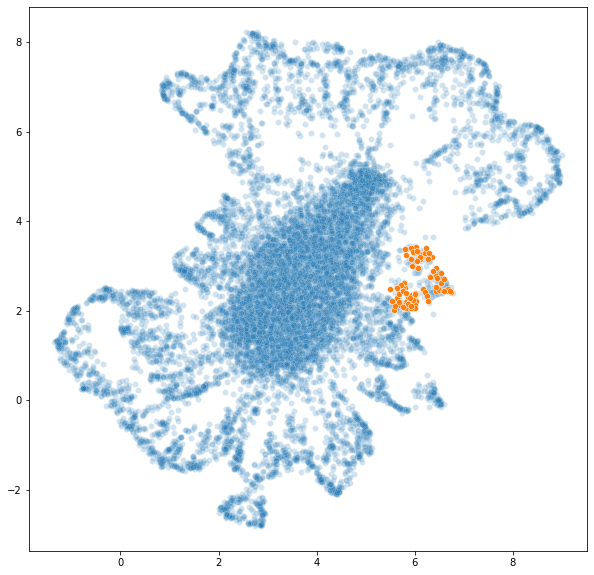

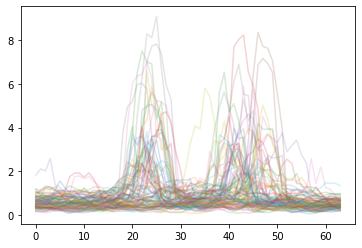

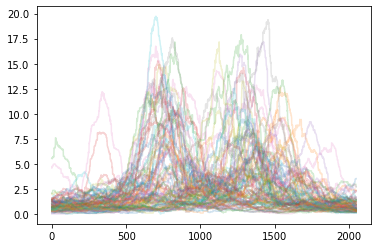

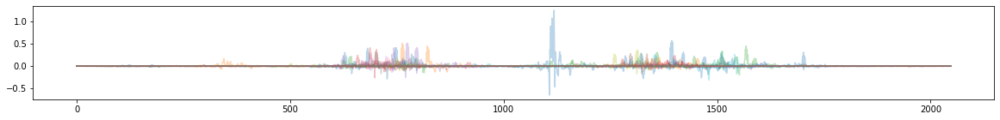

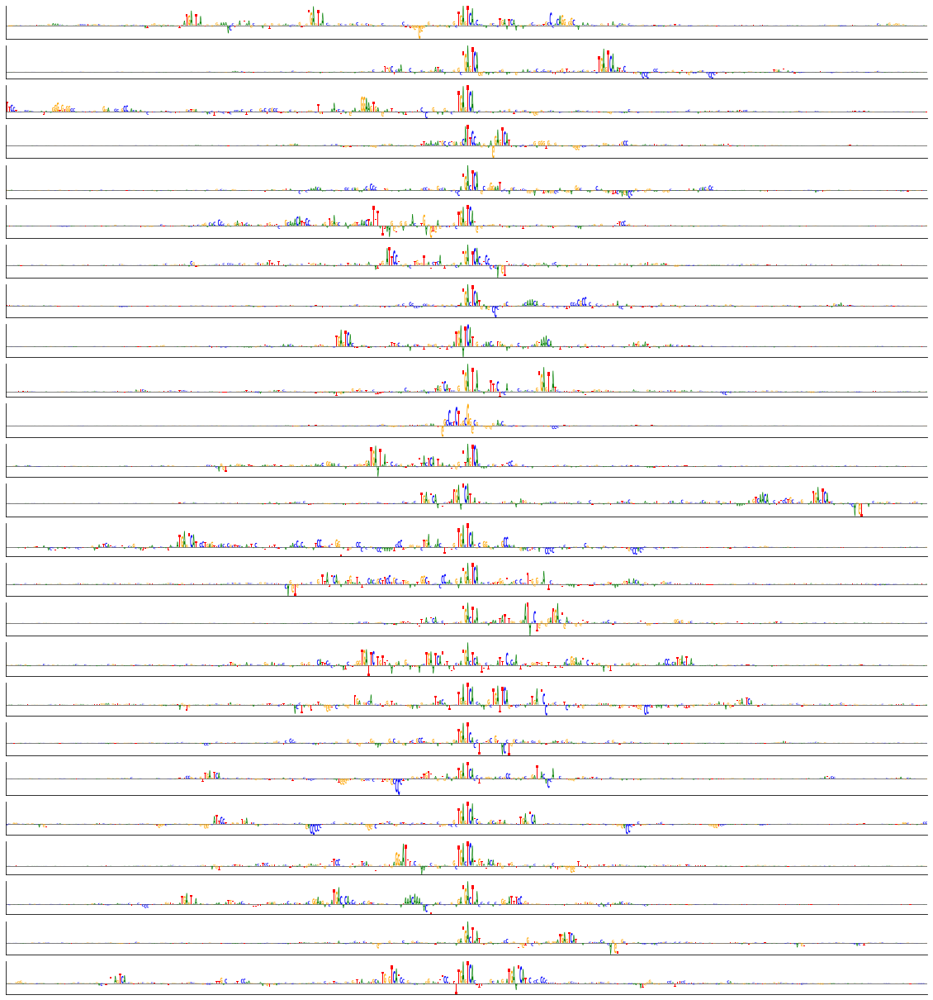

In [ ]:

index = np.where((y > 2)&(y < 3.8)&(x > 5.5))[0]
cluster_index = np.array(list(set(index).intersection(set(idr_index))))


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


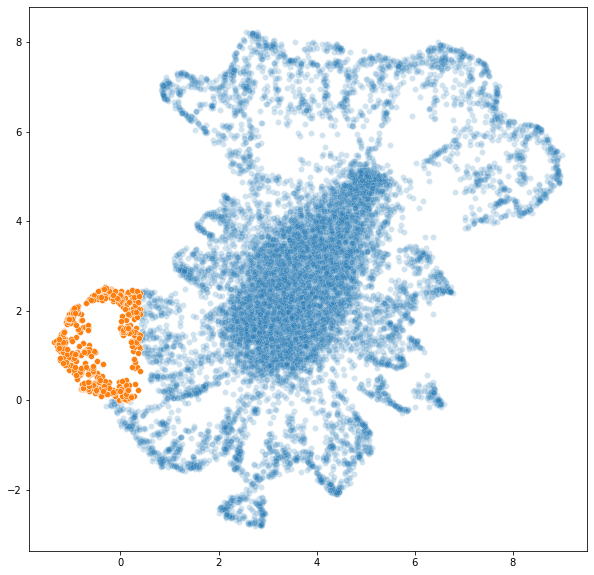

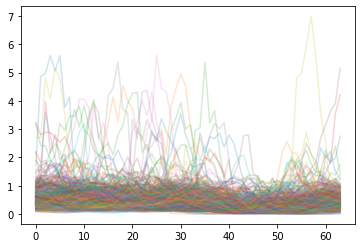

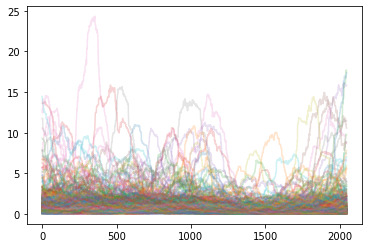

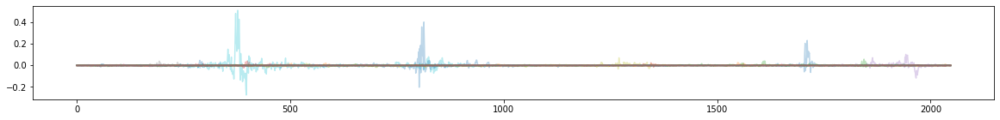

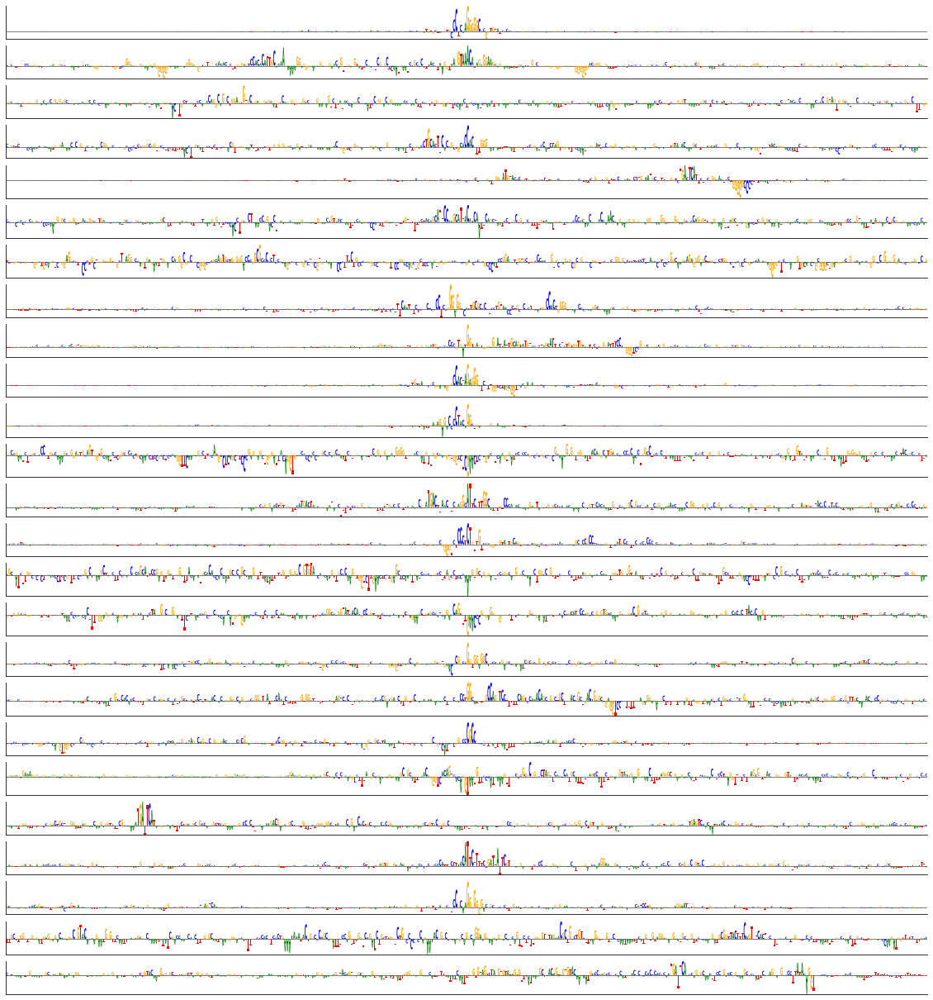

In [ ]:
cluster_index = np.where((y > 0)&(x < 0.4))[0]


plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)




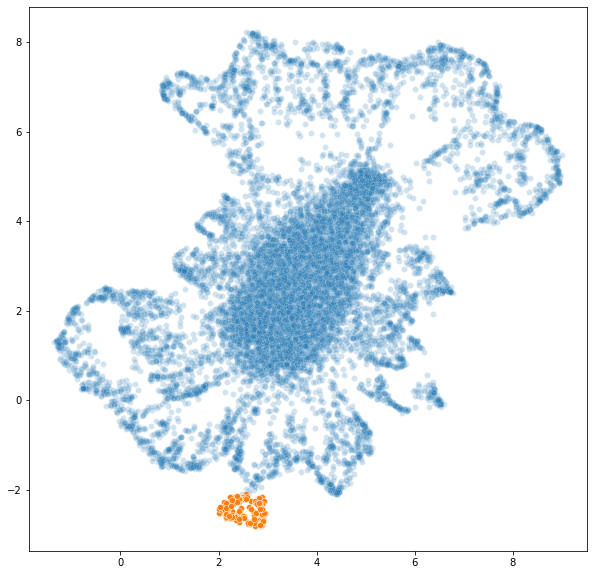

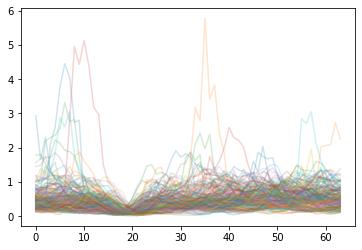

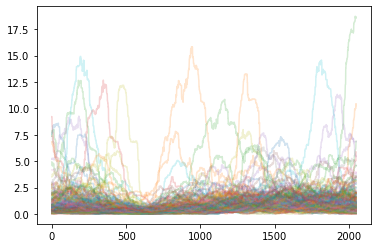

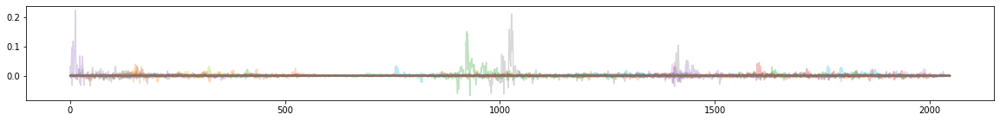

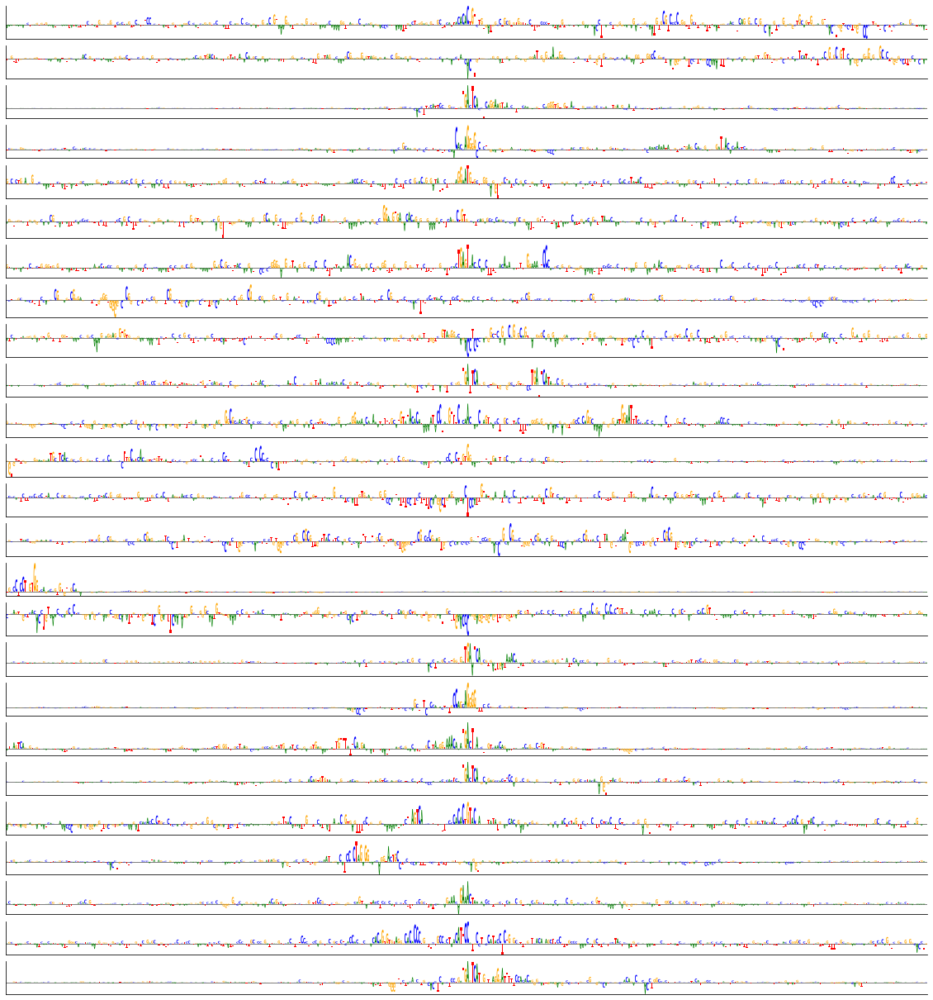

In [ ]:
cluster_index = np.where((y < -2.1))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


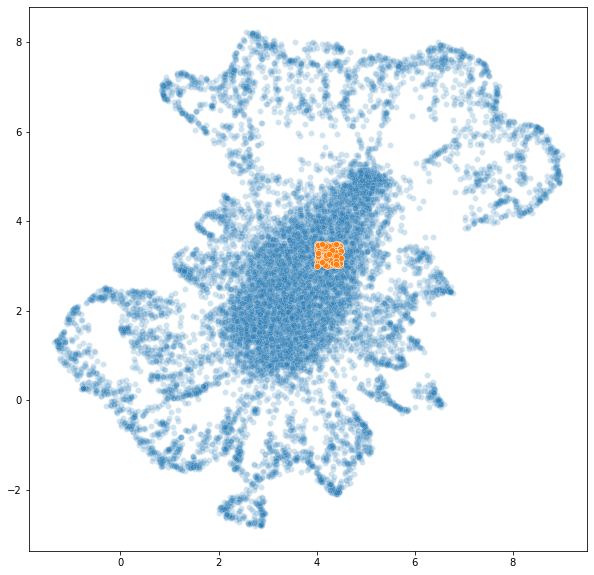

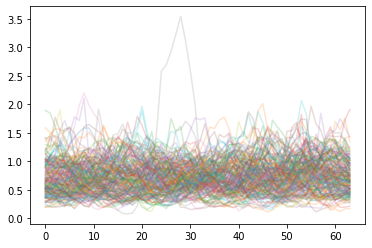

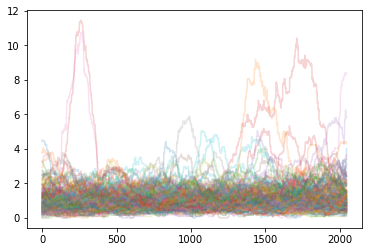

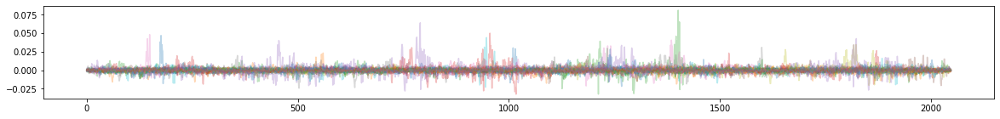

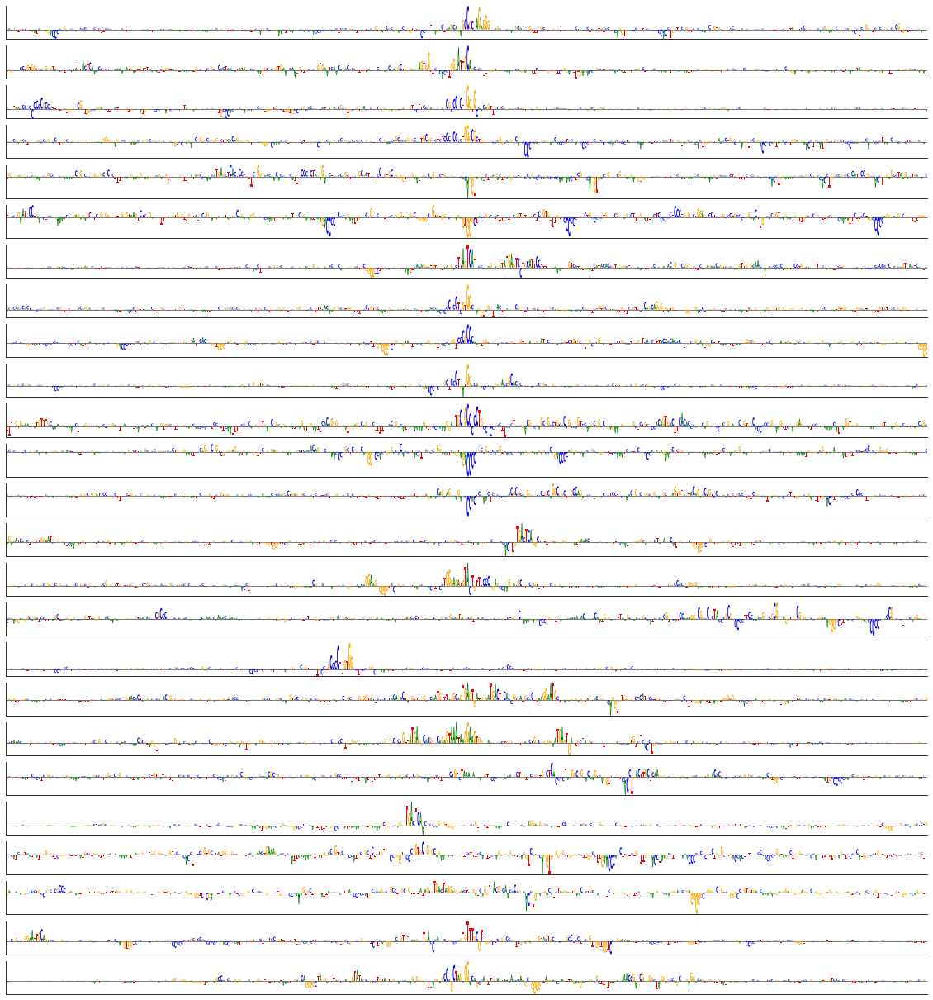

In [ ]:
cluster_index = np.where((y < 3.5)&(y > 3)&(x < 4.5)&(x > 4))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)


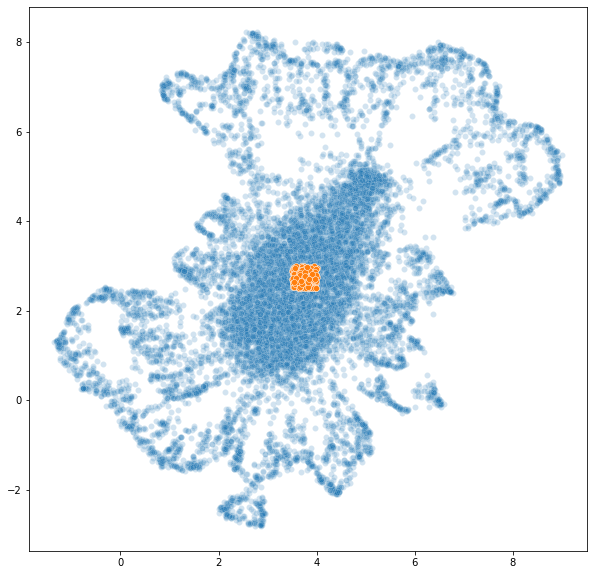

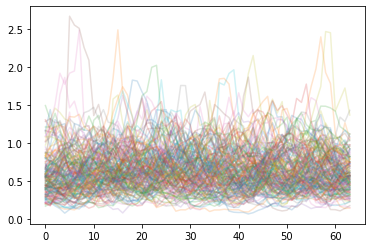

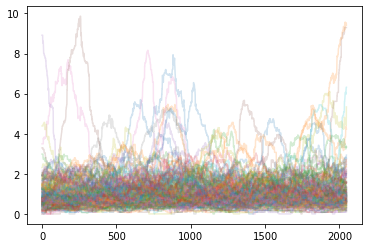

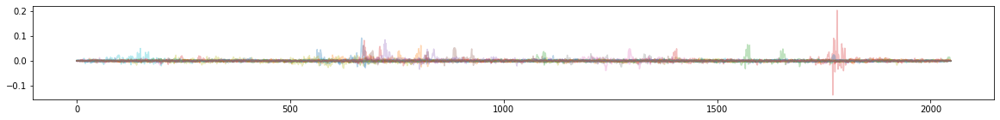

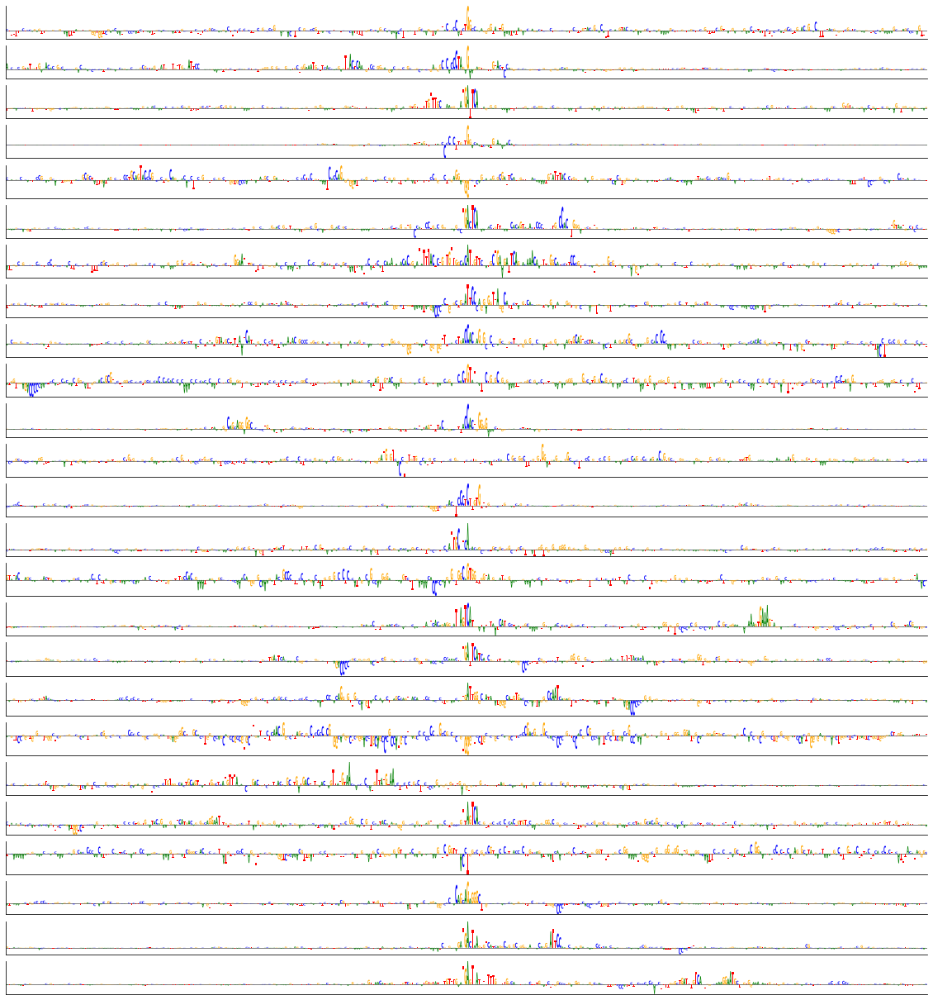

In [ ]:
cluster_index = np.where((y < 3)&(y > 2.5)&(x < 4)&(x > 3.5))[0]

plot_embedding(embedding, cluster_index)

plot_profiles(pred, cluster_index)
plot_profiles(Y, cluster_index, 0)

# plot raw saliency values
num_plot = 25
shuffle = np.random.permutation(len(cluster_index))[:num_plot]
X_sample = X[cluster_index[shuffle]]
saliency_scores = explainer.saliency_maps(X_sample)

# plot raw saliency values
plot_saliency_values(saliency_scores, X_sample)

# plot attribution maps in a narrow range about max saliency value
plot_saliency_logos(saliency_scores, X_sample, window=200)

